In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
train=pd.read_csv("Steel Plate Defect Prediction/train.csv")

In [3]:
train.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,0,584,590,909972,909977,16,8,5,2274,113,...,-0.5000,-0.0104,0.1417,0,0,0,1,0,0,0
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.7419,-0.2997,0.9491,0,0,0,0,0,0,1
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,-0.0105,-0.0944,1.0000,0,0,1,0,0,0,0
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.6667,-0.0402,0.4025,0,0,1,0,0,0,0
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.9158,-0.2455,0.9998,0,0,0,0,0,0,1


In [4]:
test=pd.read_csv("Steel Plate Defect Prediction/test.csv")

In [5]:
test.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas
0,19219,1015,1033,3826564,3826588,659,23,46,62357,67,...,0.0095,0.5652,1.0000,1.0,2.8410,1.1139,1.6628,0.6727,-0.2261,0.9172
1,19220,1257,1271,419960,419973,370,26,28,39293,92,...,0.0047,0.2414,1.0000,1.0,2.5682,0.9031,1.4472,0.9063,-0.1453,0.9104
2,19221,1358,1372,117715,117724,289,36,32,29386,101,...,0.0155,0.6000,0.7500,0.0,2.4609,1.3222,1.3222,-0.5238,-0.0435,0.6514
3,19222,158,168,232415,232440,80,10,11,8586,107,...,0.0037,0.8000,1.0000,1.0,1.9031,0.6990,1.0414,0.1818,-0.0738,0.2051
4,19223,559,592,544375,544389,140,19,15,15524,103,...,0.0158,0.8421,0.5333,0.0,2.1461,1.3222,1.1461,-0.5714,-0.0894,0.4170


In [6]:
submit=pd.read_csv("Steel Plate Defect Prediction/sample_submission.csv")

In [7]:
submit.head()

,id,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,19219,0.5,0.5,0.5,0.5,0.5,0.5,0.5
1,19220,0.5,0.5,0.5,0.5,0.5,0.5,0.5
2,19221,0.5,0.5,0.5,0.5,0.5,0.5,0.5
3,19222,0.5,0.5,0.5,0.5,0.5,0.5,0.5
4,19223,0.5,0.5,0.5,0.5,0.5,0.5,0.5


In [8]:
submit.columns

Index(['id', 'Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps',
       'Other_Faults'],
      dtype='object')

In [9]:
label=['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps','Other_Faults']

In [10]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19219 entries, 0 to 19218
Data columns (total 35 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     19219 non-null  int64  
 1   X_Minimum              19219 non-null  int64  
 2   X_Maximum              19219 non-null  int64  
 3   Y_Minimum              19219 non-null  int64  
 4   Y_Maximum              19219 non-null  int64  
 5   Pixels_Areas           19219 non-null  int64  
 6   X_Perimeter            19219 non-null  int64  
 7   Y_Perimeter            19219 non-null  int64  
 8   Sum_of_Luminosity      19219 non-null  int64  
 9   Minimum_of_Luminosity  19219 non-null  int64  
 10  Maximum_of_Luminosity  19219 non-null  int64  
 11  Length_of_Conveyer     19219 non-null  int64  
 12  TypeOfSteel_A300       19219 non-null  int64  
 13  TypeOfSteel_A400       19219 non-null  int64  
 14  Steel_Plate_Thickness  19219 non-null  int64  
 15  Ed

## Correlation

In [11]:
corr=train.corr()
corr

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
id,1.000000,0.004657,0.004406,-0.007632,-0.006422,0.000662,0.003388,0.004432,0.006150,0.006247,...,0.009182,0.006124,-0.002821,0.006174,0.002916,-0.000357,0.004396,-0.003034,0.000462,-0.005091
X_Minimum,0.004657,1.000000,0.989767,0.016071,0.014247,-0.464759,-0.451961,-0.426514,-0.430073,0.337748,...,0.276871,-0.068844,-0.376973,0.119306,-0.107581,-0.510597,0.046159,0.044439,0.205123,0.169608
X_Maximum,0.004406,0.989767,1.000000,0.018909,0.016513,-0.391937,-0.378434,-0.356528,-0.363092,0.275571,...,0.237157,-0.079235,-0.319598,0.108808,-0.126807,-0.441177,0.036824,0.037949,0.186930,0.153448
Y_Minimum,-0.007632,0.016071,0.018909,1.000000,0.969552,-0.007370,-0.012712,-0.024876,-0.008189,-0.017321,...,-0.044202,-0.023000,-0.031511,-0.015512,-0.012143,0.010612,-0.039151,-0.005449,0.056442,-0.019227
Y_Maximum,-0.006422,0.014247,0.016513,0.969552,1.000000,-0.007019,-0.012377,-0.024798,-0.007809,-0.018739,...,-0.042490,-0.022869,-0.030345,-0.016287,-0.012899,0.011304,-0.040874,-0.007416,0.056610,-0.018533
Pixels_Areas,0.000662,-0.464759,-0.391937,-0.007370,-0.007019,1.000000,0.835079,0.834543,0.797843,-0.622867,...,-0.269013,-0.015081,0.542672,-0.101295,-0.081567,0.701014,-0.077470,-0.053548,-0.224037,-0.195931
X_Perimeter,0.003388,-0.451961,-0.378434,-0.012712,-0.012377,0.835079,1.000000,0.912579,0.802072,-0.603891,...,-0.234969,0.005212,0.561256,-0.104322,-0.070433,0.675056,-0.084615,-0.050186,-0.218289,-0.186234
Y_Perimeter,0.004432,-0.426514,-0.356528,-0.024876,-0.024798,0.834543,0.912579,1.000000,0.809171,-0.602826,...,-0.113968,-0.005650,0.608167,-0.064965,-0.062092,0.630270,-0.100204,-0.019334,-0.227256,-0.174581
Sum_of_Luminosity,0.006150,-0.430073,-0.363092,-0.008189,-0.007809,0.797843,0.802072,0.809171,1.000000,-0.580857,...,-0.234625,-0.013845,0.520282,-0.093160,-0.059598,0.640597,-0.074245,-0.046712,-0.207316,-0.184651
Minimum_of_Luminosity,0.006247,0.337748,0.275571,-0.017321,-0.018739,-0.622867,-0.603891,-0.602826,-0.580857,1.000000,...,0.179385,0.619174,-0.504692,-0.004622,0.061146,-0.586957,0.166976,0.077386,0.134339,0.208857


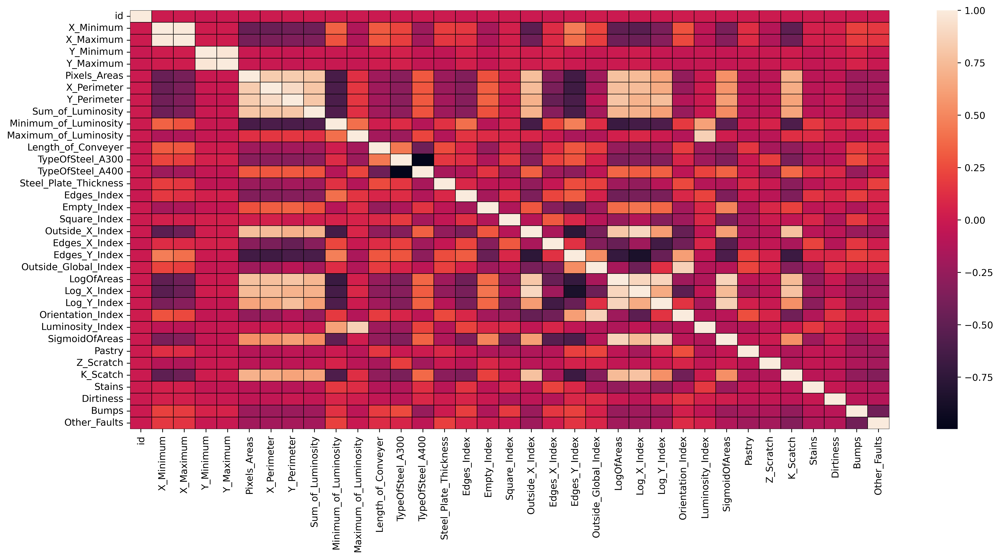

In [12]:
plt.figure(figsize=(18,8),dpi=500)
sns.heatmap(corr,linecolor='black',linewidths=0.3)
plt.show()

<Figure size 9000x500 with 0 Axes>

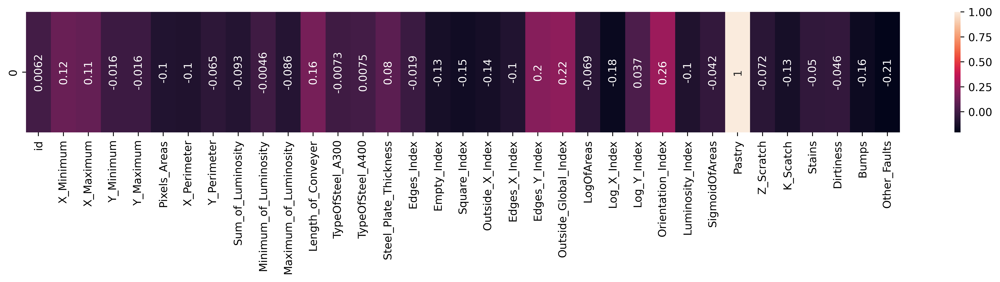

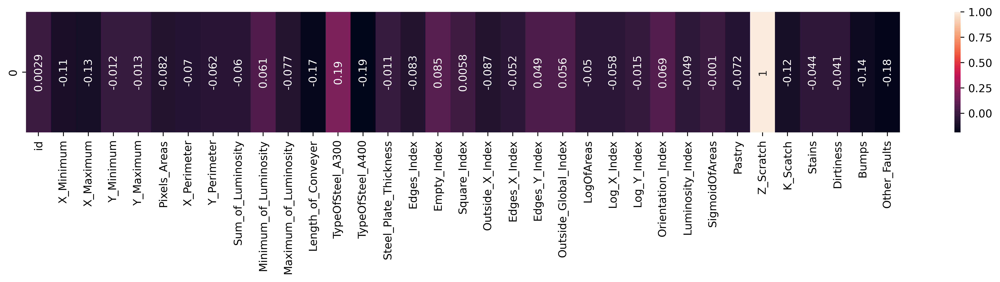

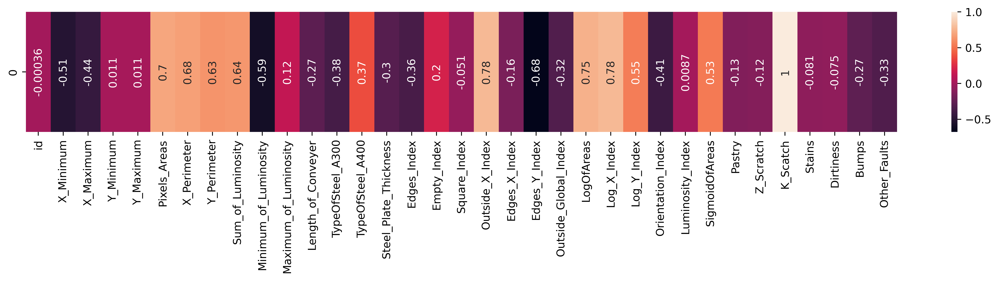

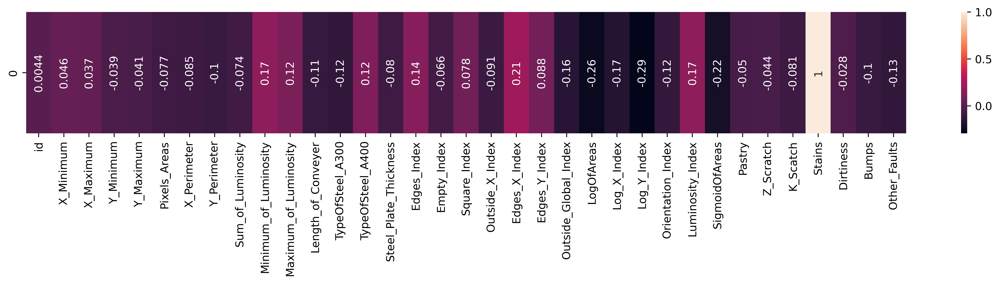

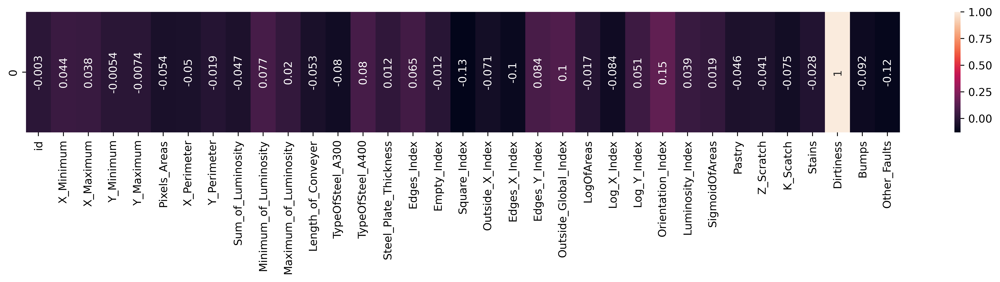

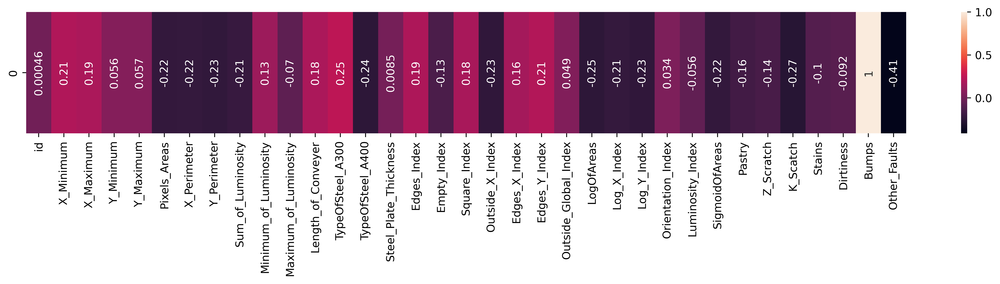

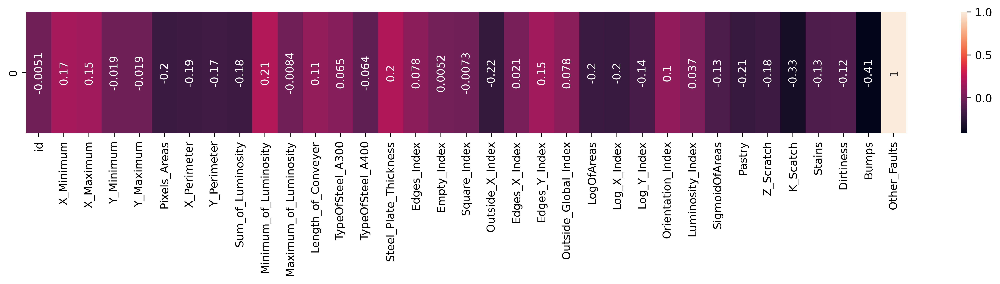

In [13]:
plt.figure(figsize=(18,1),dpi=500)
for i in label:
    plt.figure(figsize=(18,2),dpi=500)
    corr=train.corrwith(train[i])
    corr=corr.to_frame().T
    sns.heatmap(corr,annot=True,annot_kws={"rotation": 90})
    plt.show()

# EDA

## Null value

In [14]:
train.isnull().sum()

id                       0
X_Minimum                0
X_Maximum                0
Y_Minimum                0
Y_Maximum                0
Pixels_Areas             0
X_Perimeter              0
Y_Perimeter              0
Sum_of_Luminosity        0
Minimum_of_Luminosity    0
Maximum_of_Luminosity    0
Length_of_Conveyer       0
TypeOfSteel_A300         0
TypeOfSteel_A400         0
Steel_Plate_Thickness    0
Edges_Index              0
Empty_Index              0
Square_Index             0
Outside_X_Index          0
Edges_X_Index            0
Edges_Y_Index            0
Outside_Global_Index     0
LogOfAreas               0
Log_X_Index              0
Log_Y_Index              0
Orientation_Index        0
Luminosity_Index         0
SigmoidOfAreas           0
Pastry                   0
Z_Scratch                0
K_Scatch                 0
Stains                   0
Dirtiness                0
Bumps                    0
Other_Faults             0
dtype: int64

<p style="color:#333333;""><span style="background-color: #e6e6fa; display: inline-block; padding: 5px;"><b>Numerical Columns has 0 Null value</b></span></p>


## Outlier Detection

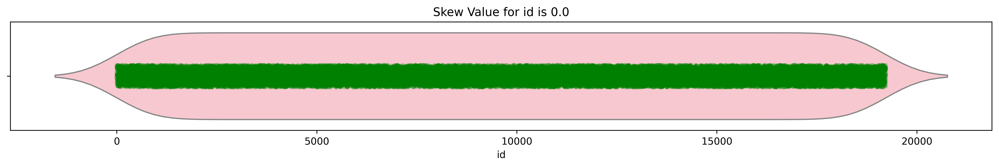

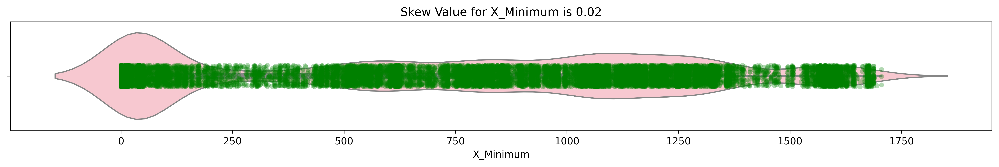

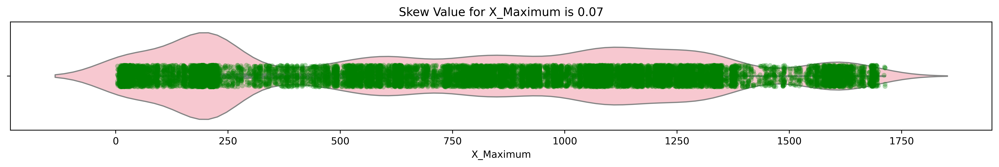

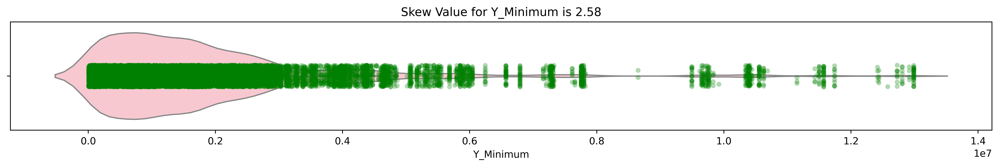

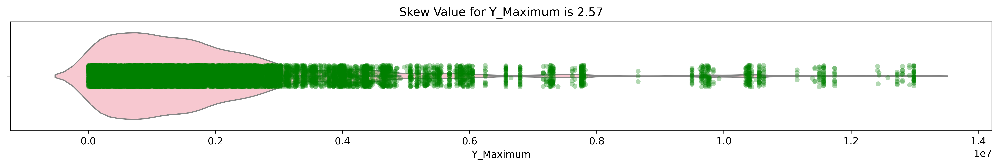

...

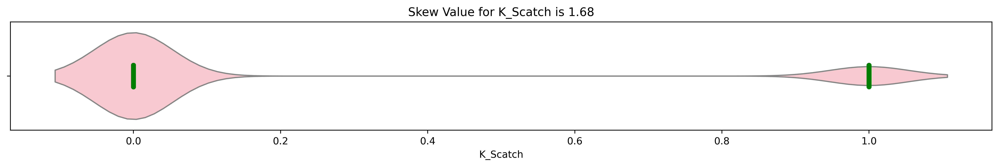

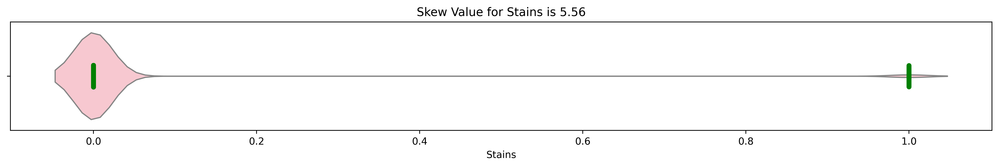

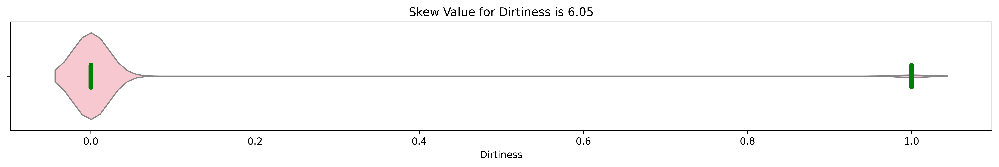

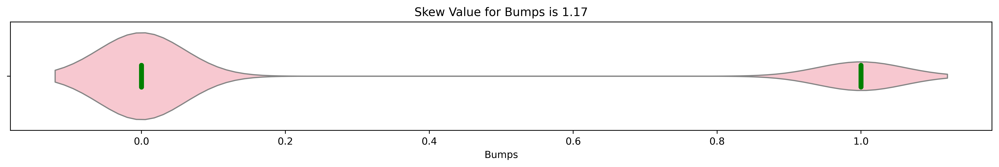

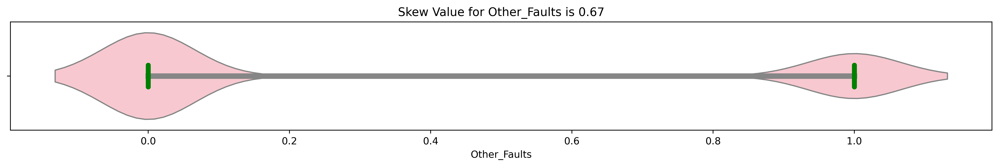

In [15]:

for i in train:
    skew=train[i].skew()
    plt.figure(figsize=(18,2),dpi=500)
    sns.violinplot(x=train[i],color='pink')
    sns.stripplot(x=train[i],color='green',alpha=0.3)
    plt.title(f"Skew Value for {i} is {round(skew,2)}")
    plt.show()

In [16]:
train.skew().sort_values(ascending=False,key=(lambda x: abs(x)))

Pixels_Areas             6.978563
Sum_of_Luminosity        6.689448
X_Perimeter              6.318097
Dirtiness                6.054619
Stains                   5.556216
Z_Scratch                3.711869
Pastry                   3.192803
Outside_X_Index          3.119207
Y_Perimeter              2.977411
Y_Minimum                2.578858
Y_Maximum                2.571989
Steel_Plate_Thickness    2.357449
K_Scatch                 1.678623
Maximum_of_Luminosity    1.171199
Bumps                    1.168228
Log_X_Index              1.098331
Edges_Y_Index           -0.984451
LogOfAreas               0.859080
Length_of_Conveyer       0.855247
Luminosity_Index         0.777712
Other_Faults             0.669819
Edges_Index              0.543361
TypeOfSteel_A300         0.396925
TypeOfSteel_A400        -0.392737
Log_Y_Index              0.387160
Outside_Global_Index    -0.373797
Minimum_of_Luminosity   -0.330581
Edges_X_Index           -0.246196
SigmoidOfAreas           0.222536
Empty_Index   

In [17]:
label

['Pastry',
 'Z_Scratch',
 'K_Scatch',
 'Stains',
 'Dirtiness',
 'Bumps',
 'Other_Faults']

In [18]:
dict={}
for i in train:
    if i in label:
        pass
    else:
        skew_value=train[i].skew().round(2)
        dict[i]=skew_value

In [19]:
outlier=[]
num_without_outlier=[]
for key, value in dict.items():
    if value>2.0:
        print(key)
        outlier.append(key)
    else:
        num_without_outlier.append(key)

Y_Minimum
Y_Maximum
Pixels_Areas
X_Perimeter
Y_Perimeter
Sum_of_Luminosity
Steel_Plate_Thickness
Outside_X_Index


In [82]:
num_without_outlier

['id',
 'X_Minimum',
 'X_Maximum',
 'Minimum_of_Luminosity',
 'Maximum_of_Luminosity',
 'Length_of_Conveyer',
 'TypeOfSteel_A300',
 'TypeOfSteel_A400',
 'Edges_Index',
 'Empty_Index',
 'Square_Index',
 'Edges_X_Index',
 'Edges_Y_Index',
 'Outside_Global_Index',
 'LogOfAreas',
 'Log_X_Index',
 'Log_Y_Index',
 'Orientation_Index',
 'Luminosity_Index',
 'SigmoidOfAreas']

In [20]:
outlier

['Y_Minimum',
 'Y_Maximum',
 'Pixels_Areas',
 'X_Perimeter',
 'Y_Perimeter',
 'Sum_of_Luminosity',
 'Steel_Plate_Thickness',
 'Outside_X_Index']

<h4 style="color:#333333;""><span style="background-color: #e6e6fa; display: inline-block; padding: 5px;"><b>Train Dataset has 8 Outlier Columns</b></span></h4>

# Model Prepration

In [93]:
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.compose import ColumnTransformer

from sklearn.preprocessing import FunctionTransformer,StandardScaler

from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.multioutput import MultiOutputRegressor
import xgboost as xgb
from sklearn.metrics import classification_report,roc_auc_score,roc_curve,auc

In [65]:
num_outlier=make_pipeline(
    FunctionTransformer(np.log),
    StandardScaler()
)
num=make_pipeline(
    StandardScaler()
)

In [66]:
preprocess=ColumnTransformer([
    ("num-out",num_outlier,outlier),
    ("num",num,num_without_outlier)
])

In [76]:
xgboost_params = {
    "objective": "binary:logistic",
    "eval_metric": "auc",
    "learning_rate": 0.005,
    "subsample": 0.85,
    "colsample_bytree": 0.85,
    "alpha": 0.001,
    "lambda": 0.001,
    "gamma": 0.1,
    "min_child_weight": 5,
    "n_estimators": 1500,
    "random_state": 42
}

In [77]:
pipeline=Pipeline([
    ('preprocess',preprocess),
    ('model',xgb.XGBClassifier(**xgboost_params))
])

In [78]:
pipeline

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('num-out',
                                                  Pipeline(steps=[('functiontransformer',
                                                                   FunctionTransformer(func=<ufunc 'log'>)),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['Y_Minimum', 'Y_Maximum',
                                                   'Pixels_Areas',
                                                   'X_Perimeter', 'Y_Perimeter',
                                                   'Sum_of_Luminosity',
                                                   'Steel_Plate_Thickness',
                                                   'Outside_X_Index']),
                                                 ('num',
                                                  Pipeline(steps=[('sta...
                               feature_types=None, gamma=0.1, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, lambda=0.001,
                               learning_rate=0.005, max_bin=None,
                               max_cat_threshold=None, max_cat_to_onehot=None,
                               max_delta_step=None, max_depth=None,
                               max_leaves=None, min_child_weight=5, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=1500, n_jobs=None, ...))])

In [79]:
x=train.drop(label,axis=1)
y=train[label]

In [80]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [81]:
pipeline.fit(X_train,y_train)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('num-out',
                                                  Pipeline(steps=[('functiontransformer',
                                                                   FunctionTransformer(func=<ufunc 'log'>)),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['Y_Minimum', 'Y_Maximum',
                                                   'Pixels_Areas',
                                                   'X_Perimeter', 'Y_Perimeter',
                                                   'Sum_of_Luminosity',
                                                   'Steel_Plate_Thickness',
                                                   'Outside_X_Index']),
                                                 ('num',
                                                  Pipeline(steps=[('sta...
                               feature_types=None, gamma=0.1, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, lambda=0.001,
                               learning_rate=0.005, max_bin=None,
                               max_cat_threshold=None, max_cat_to_onehot=None,
                               max_delta_step=None, max_depth=None,
                               max_leaves=None, min_child_weight=5, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=1500, n_jobs=None, ...))])

In [82]:
y_pred = pipeline.predict_proba(X_test)

In [83]:
roc_auc_score(y_test,y_pred)

0.887461927363355

In [87]:
from sklearn.preprocessing import label_binarize
y_test_one_hot = label_binarize(y_test, classes=[0, 1, 2, 3,4,5,6])

In [106]:
y_test_one_hot[:,1]

array([0, 0, 0, ..., 0, 0, 0])

In [107]:
y_pred[:,1]

array([0.00478787, 0.00596245, 0.00178374, ..., 0.01605087, 0.00364899,
       0.00116271], dtype=float32)

In [94]:
fpr = {}
tpr = {}
roc_auc = {}
for i in range(7):
    fpr[i], tpr[i],_= roc_curve(y_test_one_hot[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])


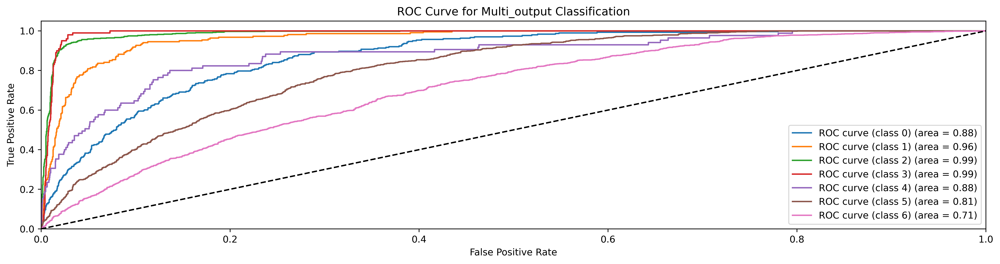

In [100]:
plt.figure(figsize=(18,4),dpi=500)
for i in range(7):
    plt.plot(fpr[i], tpr[i], label=f'ROC curve (class {i}) (area = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')  
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Multi_output Classification')
plt.legend(loc="lower right")
plt.show()

---------------------------------------------------------------------------------------------------

------------------------------------------------------------------------------------------------------------------------

## USing Different Approach

In [98]:
def add_features(df):
    df['X_Diff'] = (df['X_Maximum'] - df['X_Minimum'])
    df['Y_Diff'] = (df['Y_Maximum'] - df['Y_Minimum'])
    df['Luminosity_Diff'] = (df['Maximum_of_Luminosity'] - df['Minimum_of_Luminosity'])
    return df

In [99]:
train = add_features(train)
test = add_features(test)

In [100]:
for i in label:
    pipeline.fit(X_train,y_train[i])
    y_pred = pipeline.predict(X_test)
    print(classification_report(y_test[i],y_pred))
    print(f"ROC SCORE FOR {i}:-",roc_auc_score(y_test[i],y_pred))

              precision    recall  f1-score   support

           0       0.93      0.99      0.96      3543
           1       0.52      0.15      0.24       301

    accuracy                           0.92      3844
   macro avg       0.72      0.57      0.60      3844
weighted avg       0.90      0.92      0.90      3844

ROC SCORE FOR Pastry:- 0.5703436564354588
              precision    recall  f1-score   support

           0       0.97      0.98      0.98      3624
           1       0.62      0.54      0.58       220

    accuracy                           0.95      3844
   macro avg       0.80      0.76      0.78      3844
weighted avg       0.95      0.95      0.95      3844

ROC SCORE FOR Z_Scratch:- 0.7603828015251857
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      3162
           1       0.90      0.90      0.90       682

    accuracy                           0.96      3844
   macro avg       0.94      0.94      0.

## Test data

In [41]:
test.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas
0,19219,1015,1033,3826564,3826588,659,23,46,62357,67,...,0.0095,0.5652,1.0000,1.0,2.8410,1.1139,1.6628,0.6727,-0.2261,0.9172
1,19220,1257,1271,419960,419973,370,26,28,39293,92,...,0.0047,0.2414,1.0000,1.0,2.5682,0.9031,1.4472,0.9063,-0.1453,0.9104
2,19221,1358,1372,117715,117724,289,36,32,29386,101,...,0.0155,0.6000,0.7500,0.0,2.4609,1.3222,1.3222,-0.5238,-0.0435,0.6514
3,19222,158,168,232415,232440,80,10,11,8586,107,...,0.0037,0.8000,1.0000,1.0,1.9031,0.6990,1.0414,0.1818,-0.0738,0.2051
4,19223,559,592,544375,544389,140,19,15,15524,103,...,0.0158,0.8421,0.5333,0.0,2.1461,1.3222,1.1461,-0.5714,-0.0894,0.4170


In [42]:
submit

,id,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,19219,0.5,0.5,0.5,0.5,0.5,0.5,0.5
1,19220,0.5,0.5,0.5,0.5,0.5,0.5,0.5
2,19221,0.5,0.5,0.5,0.5,0.5,0.5,0.5
3,19222,0.5,0.5,0.5,0.5,0.5,0.5,0.5
4,19223,0.5,0.5,0.5,0.5,0.5,0.5,0.5
...,...,...,...,...,...,...,...,...
12809,32028,0.5,0.5,0.5,0.5,0.5,0.5,0.5
12810,32029,0.5,0.5,0.5,0.5,0.5,0.5,0.5
12811,32030,0.5,0.5,0.5,0.5,0.5,0.5,0.5
12812,32031,0.5,0.5,0.5,0.5,0.5,0.5,0.5


In [84]:
y_hat=test_data=pipeline.predict_proba(test)

In [85]:
# submitting file
rfc_prediction = pipeline.predict_proba(test)

output = pd.DataFrame({'id': test.id,
                       'Pastry': rfc_prediction[:, 0],
                       'Z_Scratch': rfc_prediction[:, 1],  
                       'K_Scatch': rfc_prediction[:, 2],
                       'Stains': rfc_prediction[:, 3],    
                       'Dirtiness': rfc_prediction[:, 4], 
                       'Bumps': rfc_prediction[:, 5], 
                       'Other_Faults': rfc_prediction[:, 6]   
})
output.to_csv('Steel Plate Defect.csv', index=False)
print("Your submission was successfully saved!")

Your submission was successfully saved!


In [47]:
rfc_prediction[0]

array([1.8744105e-01, 2.4111072e-05, 1.9654569e-04, 3.4050609e-06,
       1.0733416e-02, 7.9972968e-02, 7.0756918e-01], dtype=float32)